In [40]:
import numpy as np
def test_ds(ds, expocode, df, sample_index, segment_index, predictors):
    """ Test the ds array against the cruise dataframe for a specific sample and segment index. (They should all be equal) """
    # select an expedition
    cruise = df.loc[expocode]
    # bin the values using bin_ids (the same that is done in df_to_numpy) 
    cruise_binned = cruise[cruise['segment_id'] == segment_index].groupby('bin_id').mean()
    # extract predictor data and fco2 data for checking
    vals = cruise_binned[['fco2rec_uatm'] + predictors].values.T
    arr = np.full((len(predictors) + 1, ds.shape[2]), np.nan, dtype=np.float64)
    arr[:, :vals.size] = vals

    try:
        # assert that the values in the ds array are equal to the values in the cruise dataframe
        assert np.allclose(ds[:, sample_index], arr, equal_nan=True), "Something wrong with df_to_numpy function!"
        return True
    except AssertionError as e:
        print(f"AssertionError: {e}")
        print(f"ds[:, {sample_index}]: {ds[:, sample_index]}")
        print(f"arr: {arr}")
        print(f"index of mismatch: {np.where(~np.isclose(ds[:, sample_index], arr, equal_nan=True))}")
        return False

read collocated interpolated positions for one year

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
from data_explore import viz
year = 2010
fname_interp_socat = f'../data/SOCATv2024_interpolated2/.gridded_2d_ocean_data_for_ML/SOCATv2024-cruise_tracks_interp-collocated/socat2024-interp_tracks-collocated-{year}.pq'
df_interp_socat = pd.read_parquet(fname_interp_socat)
df_interp_socat.set_index(['expocode', 'time_1d', 'lat', 'lon'], inplace=True)
df_interp_socat = df_interp_socat.groupby(level=[0,1,2,3]).mean() # ensures unique index
df_interp_socat.columns

Index(['interpolated', 'time', 'chl_globcolour', 'chl_globcolour_uncert',
       'chl_globcolour_flags', 'time_chlgc', 'lat_chlgc', 'lon_chlgc',
       'temp_soda', 'salt_soda', 'mld_dens_soda', 'lon_soda', 'lat_soda',
       'depth_soda', 'time_soda', 'ssh_adt', 'ssh_sla', 'lat_sshcm',
       'lon_sshcm', 'time_sshcm', 'sst_cci', 'sst_cci_uncertainty', 'ice_cci',
       'time_sstcci', 'lat_sstcci', 'lon_sstcci', 'sss_cci',
       'sss_cci_random_error', 'lat_ssscci', 'lon_ssscci', 'time_ssscci'],
      dtype='object')

read collocated socat data 

In [2]:
fname_socat = f'../data/SOCATv2024_raw-collocated-1982_2021/SOCATv2024_raw_r20250307-1982_2021/SOCATv2024v_collocated-{year}.pq'
df_socat = pd.read_parquet(fname_socat)
df_socat['time_1d'] = df_socat['time'].dt.round('D')
df_socat.set_index(['expocode', 'time_1d','lat', 'lon'], inplace=True)
# df_socat = df_socat.groupby(level=[0,1,2,3]).mean()
df_socat['interpolated'] = False
# assert df_socat.index.is_unique
df_socat.head()

sal  sst_deg_c  pppp_hpa  \
expocode     time_1d    lat      lon                                     
06AQ20091129 2010-01-01 -54.3970 205.4190  33.859      7.799     981.0   
                        -54.3967 205.4189  33.861      7.788     981.0   
                        -54.3964 205.4188  33.862      7.777     981.0   
                        -54.3961 205.4186  33.864      7.767     981.0   
                        -54.3958 205.4185  33.865      7.756     981.0   

                                           woa_sss  ncep_slp_hpa  \
expocode     time_1d    lat      lon                               
06AQ20091129 2010-01-01 -54.3970 205.4190   34.074         978.1   
                        -54.3967 205.4189   34.074         978.1   
                        -54.3964 205.4188   34.074         978.1   
                        -54.3961 205.4186   34.074         978.1   
                        -54.3958 205.4185   34.074         978.1   

                                           dist_to_land_km  fco2rec_uatm  \
expocode     time_1d    lat      lon                                       
06AQ20091129 2010-01-01 -54.3970 205.4190           1000.0       336.676   
                        -54.3967 205.4189           1000.0       336.263   
                        -54.3964 205.4188           1000.0       335.964   
                        -54.3961 205.4186           1000.0       335.150   
                        -54.3958 205.4185           1000.0       335.392   

                                           fco2rec_flag                time  \
expocode     time_1d    lat      lon                                          
06AQ20091129 2010-01-01 -54.3970 205.4190             2 2010-01-01 00:33:17   
                        -54.3967 205.4189             2 2010-01-01 00:34:34   
                        -54.3964 205.4188             2 2010-01-01 00:35:50   
                        -54.3961 205.4186             2 2010-01-01 00:37:06   
                        -54.3958 205.4185             2 2010-01-01 00:38:22   

                                           year  ...  ice_cci  time_sstcci  \
expocode     time_1d    lat      lon             ...                         
06AQ20091129 2010-01-01 -54.3970 205.4190  2010  ...      0.0   2010-01-01   
                        -54.3967 205.4189  2010  ...      0.0   2010-01-01   
                        -54.3964 205.4188  2010  ...      0.0   2010-01-01   
                        -54.3961 205.4186  2010  ...      0.0   2010-01-01   
                        -54.3958 205.4185  2010  ...      0.0   2010-01-01   

                                           lat_sstcci  lon_sstcci  sss_cci  \
expocode     time_1d    lat      lon                                         
06AQ20091129 2010-01-01 -54.3970 205.4190     -54.375  205.425003      NaN   
                        -54.3967 205.4189     -54.375  205.425003      NaN   
                        -54.3964 205.4188     -54.375  205.425003      NaN   
                        -54.3961 205.4186     -54.375  205.425003      NaN   
                        -54.3958 205.4185     -54.375  205.425003      NaN   

                                           sss_cci_random_error  lat_ssscci  \
expocode     time_1d    lat      lon                                          
06AQ20091129 2010-01-01 -54.3970 205.4190                   NaN         NaN   
                        -54.3967 205.4189                   NaN         NaN   
                        -54.3964 205.4188                   NaN         NaN   
                        -54.3961 205.4186                   NaN         NaN   
                        -54.3958 205.4185                   NaN         NaN   

                                           lon_ssscci  time_ssscci  \
expocode     time_1d    lat      lon                                 
06AQ20091129 2010-01-01 -54.3970 205.4190         NaN          NaT   
                        -54.3967 205.4189         NaN          NaT   
                        -54.3964 20

In [3]:
expocodes = df_socat.index.get_level_values('expocode').unique()
# choose a random expedition code for the visualization
expocode = expocodes[0]
expocode

'06AQ20091129'

select and plot the cruise on a map

In [4]:
cruise = df_socat.loc[expocode]

In [5]:

map = viz.plot_cruise_interactive_scatter_map(cruise.fco2rec_uatm,
                                               lat_name='lat', lon_name='lon', time_name='time_1d', 
                                               cmap='viridis')
map


merge the interpolated points dataframe with the socat dataframe

In [6]:
df = pd.concat([df_socat, df_interp_socat], axis=0)
df.sort_values(by='time', inplace=True)
df.shape, df_socat.shape, df_interp_socat.shape

((1504677, 40), (1312448, 40), (192229, 31))

In [7]:
assert df[df.interpolated.astype(bool)].fco2rec_uatm.isna().all(), "There are non NaN values in the interpolated data"
assert df[~df.interpolated.astype(bool)].fco2rec_uatm.notna().all(), "There are NaN values in the non-interpolated data"

show interpolated cruise for visual inspection
- if fco2 is nan then the point was interpolated

In [8]:
interpolated_cruise = df.loc[expocode]
map = viz.plot_cruise_interactive_scatter_map(interpolated_cruise.fco2rec_uatm,
                                               lat_name='lat', lon_name='lon', time_name='time_1d', 
                                               cmap='viridis')
map

### test segmentation functions

first divide_cruise which is deterministic

In [9]:
from fco2dataset.ucruise import divide_cruise

# divide cruise assign every point to a segment and a bin and sorts the entries by time
srt_cruise = divide_cruise(interpolated_cruise, 
                           num_windows=64, 
                           len_window=5)

In [10]:
srt_cruise.columns

Index(['sal', 'sst_deg_c', 'pppp_hpa', 'woa_sss', 'ncep_slp_hpa',
       'dist_to_land_km', 'fco2rec_uatm', 'fco2rec_flag', 'time', 'year',
       'chl_globcolour', 'chl_globcolour_uncert', 'chl_globcolour_flags',
       'time_chlgc', 'lat_chlgc', 'lon_chlgc', 'temp_soda', 'salt_soda',
       'mld_dens_soda', 'lon_soda', 'lat_soda', 'depth_soda', 'time_soda',
       'ssh_adt', 'ssh_sla', 'lat_sshcm', 'lon_sshcm', 'time_sshcm', 'sst_cci',
       'sst_cci_uncertainty', 'ice_cci', 'time_sstcci', 'lat_sstcci',
       'lon_sstcci', 'sss_cci', 'sss_cci_random_error', 'lat_ssscci',
       'lon_ssscci', 'time_ssscci', 'interpolated', 'bin_id', 'segment_id'],
      dtype='object')

In [11]:
segment_id = 0
map = viz.plot_cruise_interactive_scatter_map(srt_cruise[srt_cruise.segment_id == segment_id].fco2rec_uatm,
                                               lat_name='lat', lon_name='lon', time_name='time_1d', 
                                               cmap='viridis')
map

take a segment, bin the values in using the bin_ids and plot the data

In [12]:
segment = srt_cruise[srt_cruise.segment_id == segment_id]
print(segment.shape)

# bin the data using the bin_ids
segment_bins = segment.groupby('bin_id').mean()
print(segment_bins.shape)

# extract fco2rec_uatm, temperature and salinity
segment_data = segment_bins[['fco2rec_uatm', 'sst_cci', 'salt_soda']].values
print(segment_data.shape)


(855, 42)
(65, 41)
(65, 3)


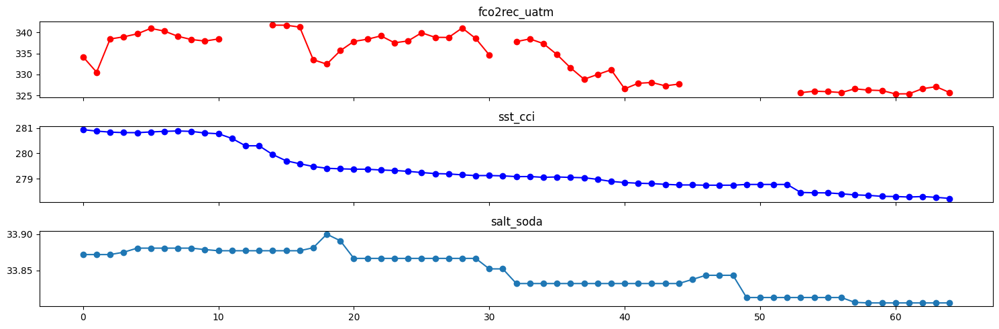

In [13]:
fig, axs = plt.subplots(3, 1, figsize=(15, 5), sharex=True)
axs[0].plot(segment_bins.index, segment_bins.fco2rec_uatm, 'o-', color='red')
axs[0].set_title('fco2rec_uatm')
axs[1].plot(segment_bins.index, segment_bins.sst_cci, 'o-', color='blue')
axs[1].set_title('sst_cci')
axs[2].plot(segment_bins.index, segment_bins.salt_soda, 'o-')
axs[2].set_title('salt_soda')
plt.tight_layout()
plt.show()


bin the values and create a small dataset using df_to_numpy. I use this function on a whole year of expeditions usually so that should also be looked at

In [14]:
srt_cruise.head()

sal  sst_deg_c  pppp_hpa  woa_sss  \
time_1d    lat      lon                                              
2010-01-01 -54.3970 205.4190  33.859      7.799     981.0   34.074   
           -54.3967 205.4189  33.861      7.788     981.0   34.074   
           -54.3964 205.4188  33.862      7.777     981.0   34.074   
           -54.3961 205.4186  33.864      7.767     981.0   34.074   
           -54.3958 205.4185  33.865      7.756     981.0   34.074   

                              ncep_slp_hpa  dist_to_land_km  fco2rec_uatm  \
time_1d    lat      lon                                                     
2010-01-01 -54.3970 205.4190         978.1           1000.0       336.676   
           -54.3967 205.4189         978.1           1000.0       336.263   
           -54.3964 205.4188         978.1           1000.0       335.964   
           -54.3961 205.4186         978.1           1000.0       335.150   
           -54.3958 205.4185         978.1           1000.0       335.392   

                              fco2rec_flag                time    year  ...  \
time_1d    lat      lon                                                 ...   
2010-01-01 -54.3970 205.4190           2.0 2010-01-01 00:33:17  2010.0  ...   
           -54.3967 205.4189           2.0 2010-01-01 00:34:34  2010.0  ...   
           -54.3964 205.4188           2.0 2010-01-01 00:35:50  2010.0  ...   
           -54.3961 205.4186           2.0 2010-01-01 00:37:06  2010.0  ...   
           -54.3958 205.4185           2.0 2010-01-01 00:38:22  2010.0  ...   

                              lat_sstcci  lon_sstcci  sss_cci  \
time_1d    lat      lon                                         
2010-01-01 -54.3970 205.4190     -54.375  205.425003      NaN   
           -54.3967 205.4189     -54.375  205.425003      NaN   
           -54.3964 205.4188     -54.375  205.425003      NaN   
           -54.3961 205.4186     -54.375  205.425003      NaN   
           -54.3958 205.4185     -54.375  205.425003      NaN   

                             sss_cci_random_error  lat_ssscci  lon_ssscci  \
time_1d    lat      lon                                                     
2010-01-01 -54.3970 205.4190                  NaN         NaN         NaN   
           -54.3967 205.4189                  NaN         NaN         NaN   
           -54.3964 205.4188                  NaN         NaN         NaN   
           -54.3961 205.4186                  NaN         NaN         NaN   
           -54.3958 205.4185                  NaN         NaN         NaN   

                              time_ssscci  interpolated  bin_id  segment_id  
time_1d    lat      lon                                                      
2010-01-01 -54.3970 205.4190          NaT           0.0       0           0  
           -54.3967 205.4189          NaT           0.0       0           0  
           -54.3964 205.4188          NaT           0.0       0           0  
           -54.3961 205.4186          NaT           0.0       0           0  
           -54.3958 205.4185          NaT           0.0       0           0  

[5 rows x 42 columns]

In [15]:
# add expocode to the index at level 0, otherwise df_to_numpy breaks
srt_cruise['expocode'] = expocode
srt_cruise.reset_index(inplace=True)
# set the index to expocode, time_1d, lat, lon and drop the bin_id and segment_id columns
srt_cruise.set_index(['expocode', 'time_1d', 'lat', 'lon'], inplace=True)
srt_cruise.head()


sal  sst_deg_c  pppp_hpa  \
expocode     time_1d    lat      lon                                     
06AQ20091129 2010-01-01 -54.3970 205.4190  33.859      7.799     981.0   
                        -54.3967 205.4189  33.861      7.788     981.0   
                        -54.3964 205.4188  33.862      7.777     981.0   
                        -54.3961 205.4186  33.864      7.767     981.0   
                        -54.3958 205.4185  33.865      7.756     981.0   

                                           woa_sss  ncep_slp_hpa  \
expocode     time_1d    lat      lon                               
06AQ20091129 2010-01-01 -54.3970 205.4190   34.074         978.1   
                        -54.3967 205.4189   34.074         978.1   
                        -54.3964 205.4188   34.074         978.1   
                        -54.3961 205.4186   34.074         978.1   
                        -54.3958 205.4185   34.074         978.1   

                                           dist_to_land_km  fco2rec_uatm  \
expocode     time_1d    lat      lon                                       
06AQ20091129 2010-01-01 -54.3970 205.4190           1000.0       336.676   
                        -54.3967 205.4189           1000.0       336.263   
                        -54.3964 205.4188           1000.0       335.964   
                        -54.3961 205.4186           1000.0       335.150   
                        -54.3958 205.4185           1000.0       335.392   

                                           fco2rec_flag                time  \
expocode     time_1d    lat      lon                                          
06AQ20091129 2010-01-01 -54.3970 205.4190           2.0 2010-01-01 00:33:17   
                        -54.3967 205.4189           2.0 2010-01-01 00:34:34   
                        -54.3964 205.4188           2.0 2010-01-01 00:35:50   
                        -54.3961 205.4186           2.0 2010-01-01 00:37:06   
                        -54.3958 205.4185           2.0 2010-01-01 00:38:22   

                                             year  ...  lat_sstcci  \
expocode     time_1d    lat      lon               ...               
06AQ20091129 2010-01-01 -54.3970 205.4190  2010.0  ...     -54.375   
                        -54.3967 205.4189  2010.0  ...     -54.375   
                        -54.3964 205.4188  2010.0  ...     -54.375   
                        -54.3961 205.4186  2010.0  ...     -54.375   
                        -54.3958 205.4185  2010.0  ...     -54.375   

                                           lon_sstcci  sss_cci  \
expocode     time_1d    lat      lon                             
06AQ20091129 2010-01-01 -54.3970 205.4190  205.425003      NaN   
                        -54.3967 205.4189  205.425003      NaN   
                        -54.3964 205.4188  205.425003      NaN   
                        -54.3961 205.4186  205.425003      NaN   
                        -54.3958 205.4185  205.425003      NaN   

                                          sss_cci_random_error  lat_ssscci  \
expocode     time_1d    lat      lon                                         
06AQ20091129 2010-01-01 -54.3970 205.4190                  NaN         NaN   
                        -54.3967 205.4189                  NaN         NaN   
                        -54.3964 205.4188                  NaN         NaN   
                        -54.3961 205.4186                  NaN         NaN   
                        -54.3958 205.4185                  NaN         NaN   

                                           lon_ssscci  time_ssscci  \
expocode     time_1d    lat      lon                                 
06AQ20091129 2010-01-01 -54.3970 205.4190         NaN          NaT   
                        -54.3967 205.4189         NaN          NaT   
                        -54.3964 205.4188         NaN          NaT   
                        -54.3961 205.4186         NaN          NaT   
                        -54.3958 205.4185 

In [16]:
from fco2dataset.ucruise import df_to_numpy
# convert the dataframe to a numpy array
predictors = ['sst_cci', 'salt_soda']
segment_data, expomap = df_to_numpy(srt_cruise, 64, predictors)

binned shape:  (1465, 40)


In [17]:
# segment data is of shape (len(predictors) + 1, num_segments, num_bins + 1)
# num_bins + 1 is a mistake in the code, it should be num_bins (when training the model I just drop the last bin)
segment_data.shape

(3, 23, 65)

In [18]:
# check that that the first dimension is equal to the number of segment ids in the cruise
segment_ids = srt_cruise.segment_id.unique()
assert segment_data.shape[1] == len(segment_ids), "The number of segments in the data does not match the number of segments in the cruise"

In [19]:
# expomap is helps for visualizing and debugging the data
# it is a dataframe that maps expocodes to the indices in segment_data corrsponding to the segments in that cruise
# more useful when you have more than one cruise in the dataset
expomap.head()

0
expocode     segment_id   
06AQ20091129 0           0
             1           1
             2           2
             3           3
             4           4

In [ ]:
segment_index = 0
sample_index = expomap.loc[expocode, segment_index].values[0]
test_ds(segment_data, expocode, srt_cruise, sample_index, segment_index, predictors)

True

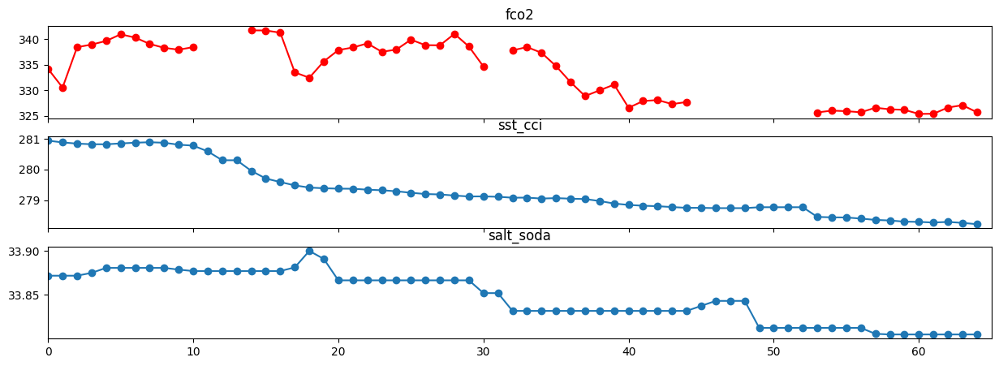

In [21]:
from fco2dataset.ucruise import plot_segment

plot_segment(segment_data[1:,:, :], segment_data[0, :, :], ['fco2', 'sst_cci', 'salt_soda'], 0)

now for divide_cruise_random

In [22]:
from fco2dataset.ucruise import divide_cruise_random

# divide cruise by selecting random starting points
# now each point can be in no segment or in multiple segments
srt_cruise_random = divide_cruise_random(interpolated_cruise, 
                                         num_windows=64, 
                                         len_window=5,
                                         rep_ratio=3 # number of selected starting points = (total cruise length / ((num_windows - 1) * len_window)) * rep_ratio
                                         )


In [23]:
srt_cruise_random.columns

Index(['index', 'segment_id', 'bin_id', 'sal', 'sst_deg_c', 'pppp_hpa',
       'woa_sss', 'ncep_slp_hpa', 'dist_to_land_km', 'fco2rec_uatm',
       'fco2rec_flag', 'time', 'year', 'chl_globcolour',
       'chl_globcolour_uncert', 'chl_globcolour_flags', 'time_chlgc',
       'lat_chlgc', 'lon_chlgc', 'temp_soda', 'salt_soda', 'mld_dens_soda',
       'lon_soda', 'lat_soda', 'depth_soda', 'time_soda', 'ssh_adt', 'ssh_sla',
       'lat_sshcm', 'lon_sshcm', 'time_sshcm', 'sst_cci',
       'sst_cci_uncertainty', 'ice_cci', 'time_sstcci', 'lat_sstcci',
       'lon_sstcci', 'sss_cci', 'sss_cci_random_error', 'lat_ssscci',
       'lon_ssscci', 'time_ssscci', 'interpolated'],
      dtype='object')

In [24]:
segment_id = 0
map = viz.plot_cruise_interactive_scatter_map(srt_cruise_random[(srt_cruise_random.segment_id == segment_id)].fco2rec_uatm,
                                               lat_name='lat', lon_name='lon', time_name='time_1d', 
                                               cmap='viridis')
map

take a segment, bin the values in using the bin_ids and plot the data

In [25]:
segment = srt_cruise_random[srt_cruise_random.segment_id == segment_id]
print(segment.shape)

# bin the data using the bin_ids
segment_bins = segment.groupby('bin_id').mean()
print(segment_bins.shape)

# extract fco2rec_uatm, temperature and salinity
segment_data = segment_bins[['fco2rec_uatm', 'sst_cci', 'salt_soda']].values
print(segment_data.shape)

(841, 43)
(64, 42)
(64, 3)


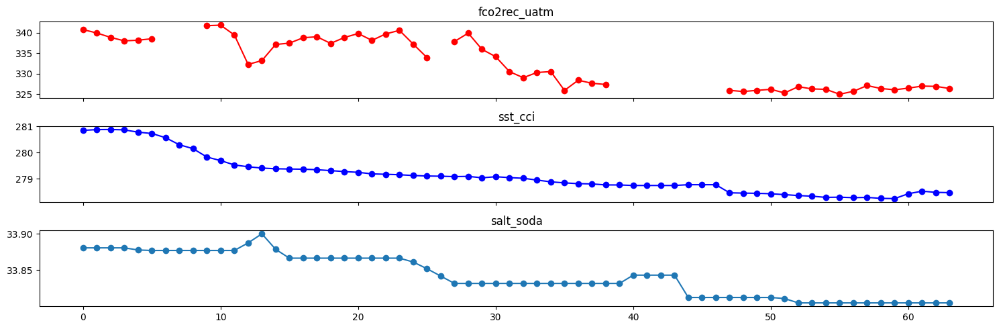

In [26]:
fig, axs = plt.subplots(3, 1, figsize=(15, 5), sharex=True)
axs[0].plot(segment_bins.index, segment_bins.fco2rec_uatm, 'o-', color='red')
axs[0].set_title('fco2rec_uatm')
axs[1].plot(segment_bins.index, segment_bins.sst_cci, 'o-', color='blue')
axs[1].set_title('sst_cci')
axs[2].plot(segment_bins.index, segment_bins.salt_soda, 'o-')
axs[2].set_title('salt_soda')
plt.tight_layout()
plt.show()

In [27]:
srt_cruise_random.head()

index  segment_id  bin_id     sal  sst_deg_c  \
time_1d    lat      lon                                                      
2010-01-01 -54.5770 205.1761    127           0       0  33.853      7.759   
           -54.5802 205.1718    128           0       0  33.853      7.759   
           -54.5834 205.1674    129           0       0  33.852      7.758   
           -54.5866 205.1631    130           0       0  33.852      7.758   
           -54.5898 205.1587    131           0       0  33.852      7.754   

                              pppp_hpa  woa_sss  ncep_slp_hpa  \
time_1d    lat      lon                                         
2010-01-01 -54.5770 205.1761     976.0   34.074         978.1   
           -54.5802 205.1718     976.0   34.074         978.1   
           -54.5834 205.1674     976.0   34.074         978.1   
           -54.5866 205.1631     976.0   34.074         978.1   
           -54.5898 205.1587     976.0   34.074         978.1   

                              dist_to_land_km  fco2rec_uatm  ...  ice_cci  \
time_1d    lat      lon                                      ...            
2010-01-01 -54.5770 205.1761           1000.0       340.793  ...      0.0   
           -54.5802 205.1718           1000.0       340.514  ...      0.0   
           -54.5834 205.1674           1000.0       340.632  ...      0.0   
           -54.5866 205.1631           1000.0       340.871  ...      0.0   
           -54.5898 205.1587           1000.0       340.867  ...      0.0   

                             time_sstcci  lat_sstcci  lon_sstcci  sss_cci  \
time_1d    lat      lon                                                     
2010-01-01 -54.5770 205.1761  2010-01-01  -54.575001  205.175003      NaN   
           -54.5802 205.1718  2010-01-01  -54.575001  205.175003      NaN   
           -54.5834 205.1674  2010-01-01  -54.575001  205.175003      NaN   
           -54.5866 205.1631  2010-01-01  -54.575001  205.175003      NaN   
           -54.5898 205.1587  2010-01-01  -54.575001  205.175003      NaN   

                              sss_cci_random_error lat_ssscci  lon_ssscci  \
time_1d    lat      lon                                                     
2010-01-01 -54.5770 205.1761                   NaN        NaN         NaN   
           -54.5802 205.1718                   NaN        NaN         NaN   
           -54.5834 205.1674                   NaN        NaN         NaN   
           -54.5866 205.1631                   NaN        NaN         NaN   
           -54.5898 205.1587                   NaN        NaN         NaN   

                              time_ssscci  interpolated  
time_1d    lat      lon                                  
2010-01-01 -54.5770 205.1761          NaT           0.0  
           -54.5802 205.1718          NaT           0.0  
           -54.5834 205.1674          NaT           0.0  
           -54.5866 205.1631          NaT           0.0  
           -54.5898 205.1587          NaT           0.0  

[5 rows x 43 columns]

In [28]:
# add expocode to the index at level 0, otherwise df_to_numpy breaks
srt_cruise_random['expocode'] = expocode
srt_cruise_random.reset_index(inplace=True)
# set the _rasrt_cruise_randomindex to expocode, time_1d, lat, lon and drop the bin_id and segment_id columns
srt_cruise_random.set_index(['expocode', 'time_1d', 'lat', 'lon'], inplace=True)
srt_cruise_random.head()

index  segment_id  bin_id     sal  \
expocode     time_1d    lat      lon                                           
06AQ20091129 2010-01-01 -54.5770 205.1761    127           0       0  33.853   
                        -54.5802 205.1718    128           0       0  33.853   
                        -54.5834 205.1674    129           0       0  33.852   
                        -54.5866 205.1631    130           0       0  33.852   
                        -54.5898 205.1587    131           0       0  33.852   

                                           sst_deg_c  pppp_hpa  woa_sss  \
expocode     time_1d    lat      lon                                      
06AQ20091129 2010-01-01 -54.5770 205.1761      7.759     976.0   34.074   
                        -54.5802 205.1718      7.759     976.0   34.074   
                        -54.5834 205.1674      7.758     976.0   34.074   
                        -54.5866 205.1631      7.758     976.0   34.074   
                        -54.5898 205.1587      7.754     976.0   34.074   

                                           ncep_slp_hpa  dist_to_land_km  \
expocode     time_1d    lat      lon                                       
06AQ20091129 2010-01-01 -54.5770 205.1761         978.1           1000.0   
                        -54.5802 205.1718         978.1           1000.0   
                        -54.5834 205.1674         978.1           1000.0   
                        -54.5866 205.1631         978.1           1000.0   
                        -54.5898 205.1587         978.1           1000.0   

                                           fco2rec_uatm  ...  ice_cci  \
expocode     time_1d    lat      lon                     ...            
06AQ20091129 2010-01-01 -54.5770 205.1761       340.793  ...      0.0   
                        -54.5802 205.1718       340.514  ...      0.0   
                        -54.5834 205.1674       340.632  ...      0.0   
                        -54.5866 205.1631       340.871  ...      0.0   
                        -54.5898 205.1587       340.867  ...      0.0   

                                          time_sstcci  lat_sstcci  lon_sstcci  \
expocode     time_1d    lat      lon                                            
06AQ20091129 2010-01-01 -54.5770 205.1761  2010-01-01  -54.575001  205.175003   
                        -54.5802 205.1718  2010-01-01  -54.575001  205.175003   
                        -54.5834 205.1674  2010-01-01  -54.575001  205.175003   
                        -54.5866 205.1631  2010-01-01  -54.575001  205.175003   
                        -54.5898 205.1587  2010-01-01  -54.575001  205.175003   

                                           sss_cci  sss_cci_random_error  \
expocode     time_1d    lat      lon                                       
06AQ20091129 2010-01-01 -54.5770 205.1761      NaN                   NaN   
                        -54.5802 205.1718      NaN                   NaN   
                        -54.5834 205.1674      NaN                   NaN   
                        -54.5866 205.1631      NaN                   NaN   
                        -54.5898 205.1587      NaN                   NaN   

                                          lat_ssscci  lon_ssscci  time_ssscci  \
expocode     time_1d    lat      lon                                            
06AQ20091129 2010-01-01 -54.5770 205.1761        NaN         NaN          NaT   
                        -54.5802 205.1718        NaN         NaN          NaT   
                        -54.5834 205.1674        NaN         NaN          NaT   
                        -54.5866 205.1631        NaN         NaN          NaT   
                        -54.5898 205.1587        NaN         NaN          NaT   

                                           interpolated  
expocode     time_1d    lat      lon                     
06AQ20091129 2010-01-01 -54.5770 205.1761           0.0  
                        -54.5802 205.1718           0.0  
          

In [29]:
from fco2dataset.ucruise import df_to_numpy
# convert the dataframe to a numpy array
predictors = ['sst_cci', 'salt_soda']
# as all segments have different segment ids df_to_numpy should work without any problems, even if the segments overlap
segment_data, expomap = df_to_numpy(srt_cruise_random, 63, predictors)
segment_data.shape

binned shape:  (4292, 41)


(3, 69, 64)

In [30]:
# segment data is of shape (len(predictors) + 1, num_segments, num_bins + 1)
# num_bins + 1 is a mistake in the code, it should be num_bins (when training the model I just drop the last bin)
# check that that the first dimension is equal to the number of segment ids in the cruise
segment_ids = srt_cruise_random.segment_id.unique()
assert segment_data.shape[1] == len(segment_ids), "The number of segments in the data does not match the number of segments in the cruise"

In [31]:
# expomap is helps for visualizing and debugging the data
# it is a dataframe that maps expocodes to the indices in segment_data corrsponding to the segments in that cruise
expomap.head()

0
expocode     segment_id   
06AQ20091129 0           0
             1           1
             2           2
             3           3
             4           4

In [32]:
segment_index = 34
sample_index = expomap.loc[expocode, segment_index].values[0]
test_ds(segment_data, expocode, srt_cruise_random, sample_index, segment_index, predictors)

True

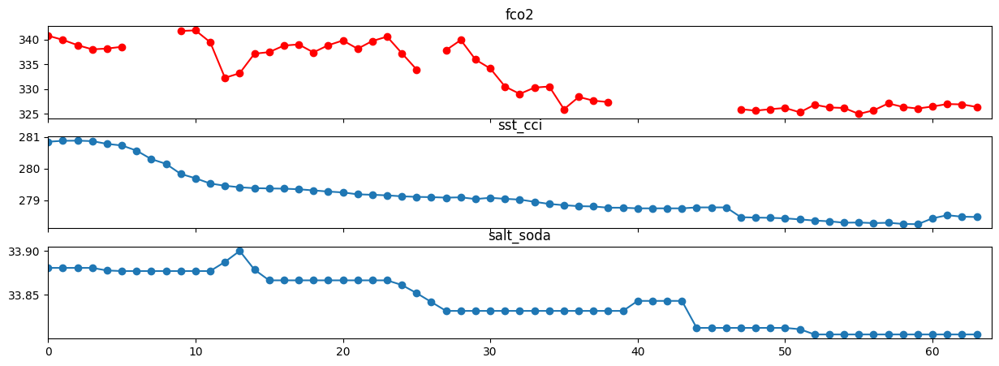

In [33]:
from fco2dataset.ucruise import plot_segment

plot_segment(segment_data[1:,:, :], segment_data[0, :, :], ['fco2', 'sst_cci', 'salt_soda'], 0)

now segment cruises for the whole year

In [34]:
NUM_BINS = 64
WINDOW_LEN = 5

df_segment = df.groupby('expocode', group_keys=False).apply(
        lambda cruise: divide_cruise(
            cruise,
            num_windows=NUM_BINS,
            len_window=WINDOW_LEN,
            max_time_delta=pd.Timedelta(days=2),
        )
)

In [35]:
df_segment.head()

sal  sst_deg_c  pppp_hpa  \
expocode     time_1d    lat      lon                                     
06AQ20091129 2010-01-01 -54.3970 205.4190  33.859      7.799     981.0   
                        -54.3967 205.4189  33.861      7.788     981.0   
                        -54.3964 205.4188  33.862      7.777     981.0   
                        -54.3961 205.4186  33.864      7.767     981.0   
                        -54.3958 205.4185  33.865      7.756     981.0   

                                           woa_sss  ncep_slp_hpa  \
expocode     time_1d    lat      lon                               
06AQ20091129 2010-01-01 -54.3970 205.4190   34.074         978.1   
                        -54.3967 205.4189   34.074         978.1   
                        -54.3964 205.4188   34.074         978.1   
                        -54.3961 205.4186   34.074         978.1   
                        -54.3958 205.4185   34.074         978.1   

                                           dist_to_land_km  fco2rec_uatm  \
expocode     time_1d    lat      lon                                       
06AQ20091129 2010-01-01 -54.3970 205.4190           1000.0       336.676   
                        -54.3967 205.4189           1000.0       336.263   
                        -54.3964 205.4188           1000.0       335.964   
                        -54.3961 205.4186           1000.0       335.150   
                        -54.3958 205.4185           1000.0       335.392   

                                           fco2rec_flag                time  \
expocode     time_1d    lat      lon                                          
06AQ20091129 2010-01-01 -54.3970 205.4190           2.0 2010-01-01 00:33:17   
                        -54.3967 205.4189           2.0 2010-01-01 00:34:34   
                        -54.3964 205.4188           2.0 2010-01-01 00:35:50   
                        -54.3961 205.4186           2.0 2010-01-01 00:37:06   
                        -54.3958 205.4185           2.0 2010-01-01 00:38:22   

                                             year  ...  lat_sstcci  \
expocode     time_1d    lat      lon               ...               
06AQ20091129 2010-01-01 -54.3970 205.4190  2010.0  ...     -54.375   
                        -54.3967 205.4189  2010.0  ...     -54.375   
                        -54.3964 205.4188  2010.0  ...     -54.375   
                        -54.3961 205.4186  2010.0  ...     -54.375   
                        -54.3958 205.4185  2010.0  ...     -54.375   

                                           lon_sstcci  sss_cci  \
expocode     time_1d    lat      lon                             
06AQ20091129 2010-01-01 -54.3970 205.4190  205.425003      NaN   
                        -54.3967 205.4189  205.425003      NaN   
                        -54.3964 205.4188  205.425003      NaN   
                        -54.3961 205.4186  205.425003      NaN   
                        -54.3958 205.4185  205.425003      NaN   

                                          sss_cci_random_error  lat_ssscci  \
expocode     time_1d    lat      lon                                         
06AQ20091129 2010-01-01 -54.3970 205.4190                  NaN         NaN   
                        -54.3967 205.4189                  NaN         NaN   
                        -54.3964 205.4188                  NaN         NaN   
                        -54.3961 205.4186                  NaN         NaN   
                        -54.3958 205.4185                  NaN         NaN   

                                           lon_ssscci  time_ssscci  \
expocode     time_1d    lat      lon                                 
06AQ20091129 2010-01-01 -54.3970 205.4190         NaN          NaT   
                        -54.3967 205.4189         NaN          NaT   
                        -54.3964 205.4188         NaN          NaT   
                        -54.3961 205.4186         NaN          NaT   
                        -54.3958 205.4185 

In [36]:
ds, expomap = df_to_numpy(
    df_segment, NUM_BINS, ['sst_cci', 'salt_soda']
)
ds.shape

binned shape:  (298159, 40)


(3, 4914, 65)

In [37]:
expomap.head()

0
expocode     segment_id   
06AQ20091129 0           0
             1           1
             2           2
             3           3
             4           4

In [38]:
segment_ids = df_segment.groupby([pd.Grouper(level='expocode'), 'segment_id']).size().shape[0]
assert ds.shape[1] == segment_ids, "The number of segments in the data does not match the number of segments in the cruise"

In [57]:
import numpy as np
def test_ds(ds, expocode, df, sample_index, segment_index, predictors):
    """ Test the ds array against the cruise dataframe for a specific sample and segment index. (They should all be equal) """
    # select an expedition
    cruise = df.loc[expocode]
    # bin the values using bin_ids (the same that is done in df_to_numpy) 
    cruise_binned = cruise[cruise['segment_id'] == segment_index].groupby('bin_id').mean()
    # extract predictor data and fco2 data for checking
    vals = cruise_binned[['fco2rec_uatm'] + predictors].values.T
    arr = np.full((len(predictors) + 1, ds.shape[2]), np.nan, dtype=np.float64)
    arr[:, :vals.shape[1]] = vals

    try:
        # assert that the values in the ds array are equal to the values in the cruise dataframe
        assert np.allclose(ds[:, sample_index], arr, equal_nan=True), "Something wrong with df_to_numpy function!"
        return True
    except AssertionError as e:
        print(f"AssertionError: {e}")
        print(f"ds[:, {sample_index}]: {ds[:, sample_index]}")
        print(f"arr: {arr}")
        print(f"index of mismatch: {np.where(~np.isclose(ds[:, sample_index], arr, equal_nan=True))}")
        return False

In [62]:
# all expocodes in the dataset
expocodes = df_segment.index.get_level_values('expocode').unique()
# select a random expedition code
expocode = expocodes[1]
print(f"number of segments in cruise {expocode}: {expomap.loc[expocode].shape[0]}")
# select a random segment id
segment_index = 10
# find sample index
sample_index = expomap.loc[expocode, segment_index].values[0]

test_ds(ds, expocode, df_segment, sample_index, segment_index, ['sst_cci', 'salt_soda'])

number of segments in cruise 06AQ20100131: 56


True